In [21]:
# importing packages
import numpy as np
import pandas as pd
import dateutil
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import geopandas as gpd
import spacy
import re
import descartes
from matplotlib import cm
import colorsys
from matplotlib import colors
from matplotlib import cm
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from matplotlib.gridspec import GridSpec
import matplotlib.ticker as ticker
import matplotlib.cm as cm
import pickle

# Setting global params for Matplotlib font
mpl.rc('text', usetex=True)
font = {'family':'serif'}
mpl.rc('font', **font)




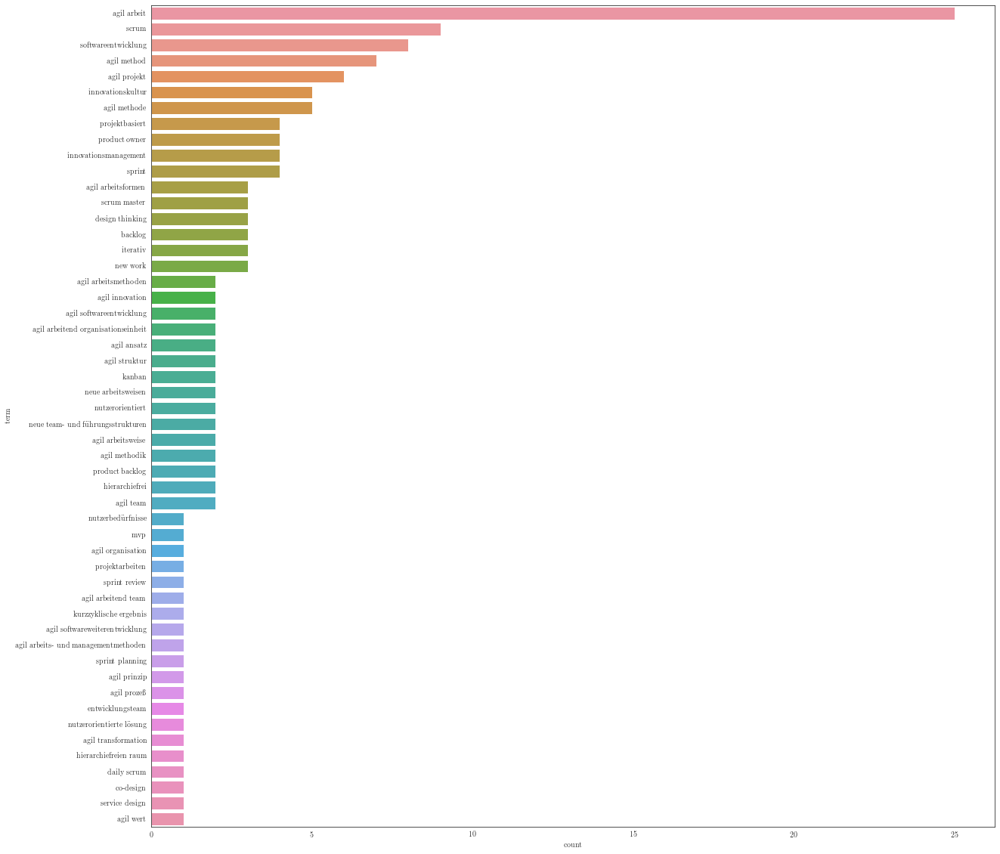

In [22]:
# counting the co-occurances for Germany
with open("../2_Data_Preprocessing/searchterms_de_eng_lemma.pickle", "rb") as file:
    searchterms_de_eng_lemma = pickle.load(file)

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv")

dict_count = {}

for term in searchterms_de_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])


df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]
plt.figure(figsize=(20,20))
sns.barplot(data=df_count, x="count", y="term", orient="h")


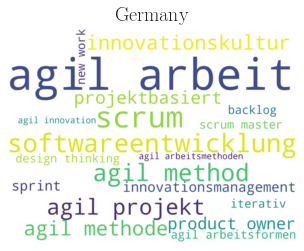

<Figure size 936x1080 with 0 Axes>

In [23]:
# Plotting wordcloud for Germany

d = {}
for a, x in df_count.values:
    d[a] = x

import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud(width=2000, height=1500, max_font_size=300, min_font_size=50, max_words=60, background_color="white", colormap="viridis")
wordcloud.generate_from_frequencies(frequencies=d)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Germany', fontsize=20)
plt.axis("off")
plt.figure(figsize=(2^15,2^13))
plt.show()
wordcloud.to_file("wordcloud_germany.png")

In [24]:
# counting co_occurence term frequency for the UK

with open("../2_Data_Preprocessing/searchterms_eng_lemma.pickle", "rb") as file:
    searchterms_eng_lemma= pickle.load(file)

df = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/UK/General_cleaned_org.csv')

dict_count = {}

for term in searchterms_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])


df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]


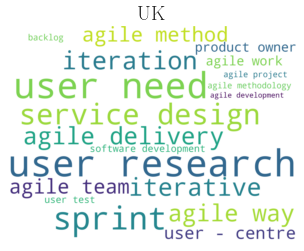

<Figure size 936x1080 with 0 Axes>

In [25]:
# Plotting wordcloud for Britain

d = {}
for a, x in df_count.values:
    d[a] = x

import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud(width=2000, height=1500, max_font_size=300, min_font_size=50, max_words=60, background_color="white", colormap="viridis")
wordcloud.generate_from_frequencies(frequencies=d)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('UK', fontsize=20)
plt.axis("off")
plt.figure(figsize=(2^15,2^13))
plt.show()
wordcloud.to_file("wordcloud_uk.png")

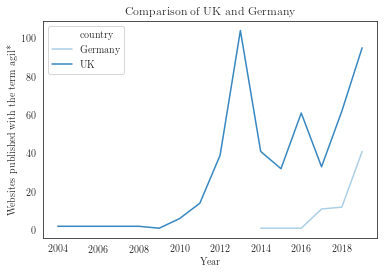

In [26]:
###### Comparing UK and Germany

inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df["Websites published with the term agil*"] = 1
df2 = df.groupby(['country', "Year"]).count()

df2.reset_index(inplace=True)
sns.set_palette('Blues', 2) 
sns.set_style("white")
sns.set_style({'font.family':'serif', 'font.serif':'Computer Modern Roman'})
line_plot = sns.lineplot(x='Year', y="Websites published with the term agil*", data=df2, hue='country').set_title("Comparison of UK and Germany",  fontsize=20)
fig = line_plot.get_figure()
fig.savefig('germany_vs_uk.png', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

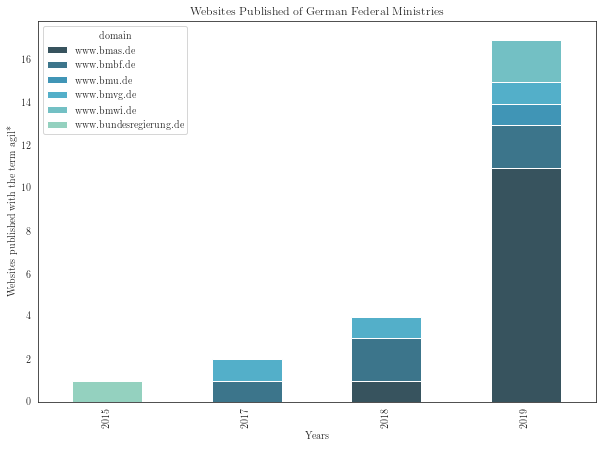

In [27]:
###### Comparing different Ministries in Germany
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['level'] == 'Federal']
df["Websites published with the term agil*"] = 1
df = df[['domain', 'Year', "Websites published with the term agil*"]]


df2 = df.groupby(['domain', "Year"]).count()
df2.reset_index(inplace=True)



pivot_df = df2.pivot(index='Year', columns="domain", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
pivot_df.append(pd.DataFrame([(0,0,0,0,0)], index=["2016"]))

colors = sns.color_palette("GnBu_d", 6).as_hex()
pivot_df.plot.bar(stacked=True, color=colors, figsize=(10,7))
plt.title('Websites Published of German Federal Ministries', fontsize=20)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.savefig('germany_ministries.png', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

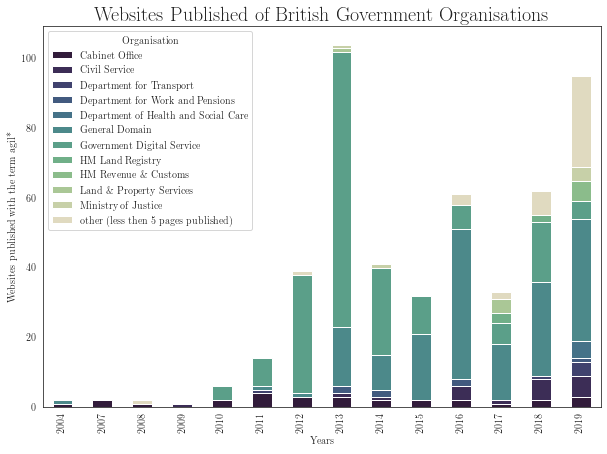

In [52]:
###### Comparing different Ministries in the uK
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['level'] == 'General']
df["Websites published with the term agil*"] = 1
df = df[['Organisation', 'Year', "Websites published with the term agil*"]]
df['Organisation'] = df['Organisation'].str.replace('&', '\&')

df2 = df.groupby(['Organisation', "Year"]).count()
df2.reset_index(inplace=True)

# everything with less then a certain number of pages will fall under "other"
total_number = 5

other = "".join(["other (less then ", str(total_number), " pages published)"])
for organisation in df2['Organisation']:
    df_sub = df2[df2['Organisation'] == organisation]
    if df_sub['Websites published with the term agil*'].sum() < total_number:
        df2["Organisation"].replace({organisation : other}, inplace=True)

df2 = df2.groupby(['Organisation', "Year"]).sum()
df2.reset_index(inplace=True)


pivot_df = df2.pivot(index='Year', columns="Organisation", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

#sns.color_palette("Blues")
colors = sns.cubehelix_palette(12, start=.6, rot=-.9, reverse=True).as_hex()
pivot_df.plot.bar(stacked=True, color=colors, figsize=(10,7))
plt.title('Websites Published of British Government Organisations', fontsize=20)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.savefig('british_organisations.png', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

In [ ]:
# calculating individual German statate's "agile readiness index"

state_list = ["Schleswig-Holstein", "Bremen", "Hamburg", "Lower Saxony", "Thuringia", "Saxony-Anhalt", "Saxony", "Mecklenburg-Vorpommern", "Berlin", "Brandenburg", "North Rhine-Westphalia", "Rhineland-Palatinate", "Saarland", "Hesse", "Bavaria", "Baden-Wuerttemberg"]

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv")

df = df[df.level != "Federal"]

state_list = ["Schleswig-Holstein", "Bremen", "Hamburg", "Lower Saxony", "Thuringia", "Saxony-Anhalt", "Saxony", "Mecklenburg-Vorpommern", "Berlin", "Brandenburg", "North Rhine-Westphalia", "Rhineland-Palatinate", "Saarland", "Hesse", "Bavaria", "Baden-Wuerttemberg"]

df_counts = df.groupby(["level"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for state in state_list:
    if state not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['level']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for state in state_list:
    if state not in df_co_terms.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3.fillna(0, inplace=True)

df3 = df3.rename(index={'Baden-Wuerttemberg': 'Baden-Württemberg'})

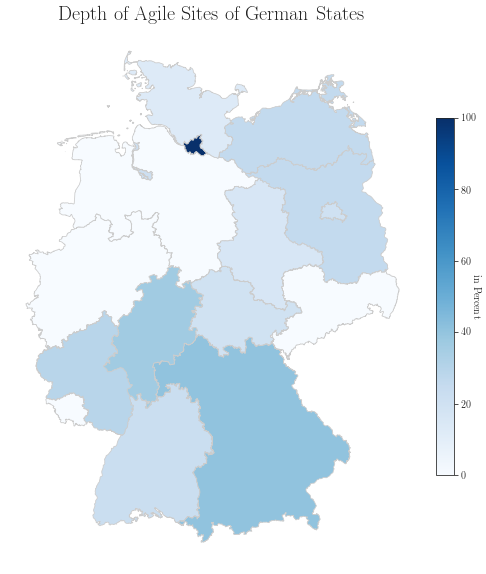

In [53]:
# plotting Germany Federal levels agile depth on map

# set the filepath and load in a shapefile
fp = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Igismap/Germany_Polygon.shp"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe

merged = map_df.set_index('name').join(df3)

# set a variable that will call whatever column we want to visualise on the map
variable = "agile_depth"
# set the range for the choropleth
vmin, vmax = 0,100
# create figure and axes for Matplotlib
figlength = 5
fig, ax = plt.subplots(1, figsize=(8,20))
# create map
merged.plot(column=variable, cmap="Blues", linewidth=0.8, ax=ax, edgecolor='0.8')
ax.set_aspect(aspect=1.55)
ax.axis("off")
# add a title
#ax.set_title('     Depth of Agile Sites of German States', fontdict={'fontsize': '20', 'fontweight' : '3'})
# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm, fraction=0.04, pad=0.04)
cbar.set_label('in Percent', rotation=270)
# saving the figure
fig.savefig('map_depth_export.png', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )


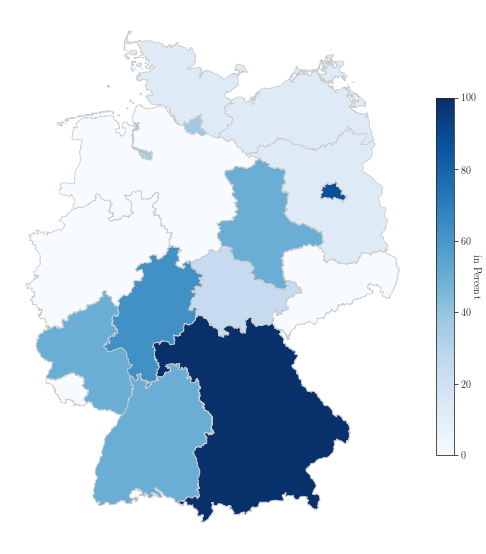

In [54]:
# plotting Germany Federal levels agile breadth on map

# set the filepath and load in a shapefile
fp = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Igismap/Germany_Polygon.shp"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe

merged = map_df.set_index('name').join(df3)

# set a variable that will call whatever column we want to visualise on the map
variable = "agile_breadth"
# set the range for the choropleth
vmin, vmax = 0,100
# create figure and axes for Matplotlib
figlength = 5
fig, ax = plt.subplots(1, figsize=(8,20))
# create map
merged.plot(column=variable, cmap="Blues", linewidth=0.8, ax=ax, edgecolor='0.8')
ax.set_aspect(aspect=1.55)
ax.axis("off")
# add a title
#ax.set_title('     Depth of Agile Sites of German States', fontdict={'fontsize': '20', 'fontweight' : '3'})
# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm, fraction=0.04, pad=0.04)
cbar.set_label('in Percent', rotation=270)
# saving the figure
fig.savefig('map_breadth_export.png', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

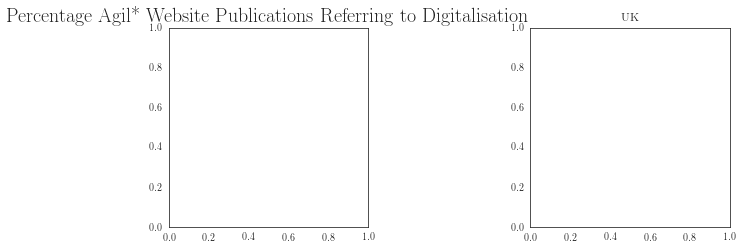

In [34]:
###### Plotting the percentage of published websites with digital
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
#UK
df_uk = df[df.country == "UK"]
df_uk['Digital'] = pd.notnull(df_uk.digital_term)
percentage_uk = df_uk.Digital.sum() / len(df_uk.Digital)
percentage_uk
chart_labels_uk = "not related to digitalisation", 'related to digitalisation'
chart_numbers_uk = [1-percentage_uk, percentage_uk]
# GERMANY
df_de = df[df.country == "Germany"]
df_de['Digital'] = pd.notnull(df_de.digital_term)
percentage_de = df_de.Digital.sum() / len(df_de.Digital)
percentage_de
chart_labels_de = "not related to digitalisation", 'related to digitalisation'
chart_numbers_de = [1-percentage_de, percentage_de]


explode = (0, 0.1)

fig, ax = plt.subplots(figsize=(10,10))
the_grid = GridSpec(2, 2)

colors = sns.color_palette('Blues',2).as_hex()

plt.subplot(the_grid[0, 1], aspect=1, title='UK')
ax.pie(chart_numbers_uk, explode=explode, labels=chart_labels_uk, autopct='%1.1f%%',
        shadow=True, startangle=90, colors = colors,textprops={'fontsize': 15})
ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.subplot(the_grid[0,0], aspect=1, title='Germany')
ax.pie(chart_numbers_de, explode=explode, labels=chart_labels_de, autopct='%1.1f%%',
        shadow=True, startangle=90, colors = colors,textprops={'fontsize': 15})
ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.


plt.title('Percentage Agil* Website Publications Referring to Digitalisation', fontsize= 20)
plt.tight_layout()
fig.savefig("percentage_digital.png", dpi=900)

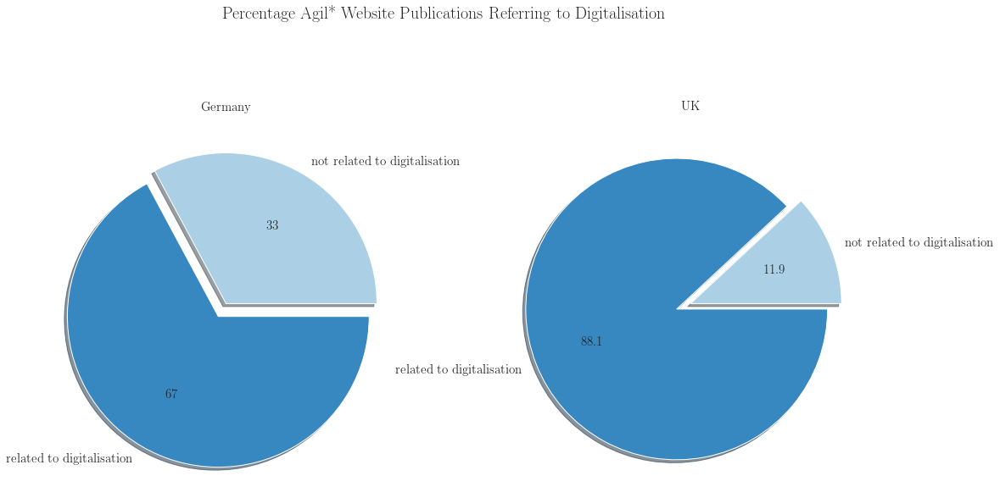

<Figure size 7200x4800 with 0 Axes>

In [32]:
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
#UK
df_uk = df[df.country == "UK"]
df_uk['Digital'] = pd.notnull(df_uk.digital_term)
percentage_uk = df_uk.Digital.sum() / len(df_uk.Digital)
percentage_uk
chart_labels_uk = "not related to digitalisation", 'related to digitalisation'
chart_numbers_uk = [1-percentage_uk, percentage_uk]
# GERMANY
df_de = df[df.country == "Germany"]
df_de['Digital'] = pd.notnull(df_de.digital_term)
percentage_de = df_de.Digital.sum() / len(df_de.Digital)
percentage_de
chart_labels_de = "not related to digitalisation", 'related to digitalisation'
chart_numbers_de = [1-percentage_de, percentage_de]

dataframe = pd.DataFrame({'country': ['Germany', 'UK'], 'not related to digitalisation': [1-percentage_de, 1-percentage_uk], 'related to digitalisation': [percentage_de, percentage_uk]})
# Make square figures and axes
plt.figure(1, figsize=(18,18))
the_grid = GridSpec(2, 2)

explode = (0, 0.1)


colors = sns.color_palette('Blues',2).as_hex()


plt.subplot(the_grid[0, 1], aspect=1, title='UK')

uk_pie = plt.pie(chart_numbers_uk, labels=chart_labels_uk, autopct='%1.1f%%',shadow=True, colors=colors, explode=explode,textprops={'fontsize': 15})
plt.title('UK', fontsize=15)

plt.subplot(the_grid[0, 0], aspect=1, title='Germany')
germany_pie = plt.pie(chart_numbers_de,labels=chart_labels_de, autopct='%.0f%%', shadow=True, colors=colors, explode=explode,textprops={'fontsize': 15})
plt.title('Germany', fontsize=15)
plt.suptitle('Percentage Agil* Website Publications Referring to Digitalisation', fontsize=20)
plt.figure(dpi=1200)
plt.tight_layout(pad=4)
plt.draw()

#plt.savefig("percentage_digital.png", dpi=900) # best it to store it manually